[![gcolab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/brainhack-school2023/Vejdani_project/blob/main/B0_field_mapping_tutorial.ipynb)



## Package installation 

In [29]:
# Uncomment follwoing lines to install required packages


# !git clone https://github.com/shimming-toolbox/shimming-toolbox.git  
# !git clone https://github.com/behrouzvia/Multi_echo_GRE_data.git 
# !pip install shimming-toolbox/
# !pip install plotly
# !pip install pybids
# !pip install datalad
# !pip install nilearn
# !pip install fmriprep
# !fmriprep --version

fMRIPrep v23.0.2


## Importing packages

In [21]:
import os 
import json
import re
import numpy as np
import pandas as pd
import scipy as sp
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.graph_objects as go
import plotly.figure_factory as ff
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots

import nibabel as nib
import datalad.api as dl
from bids import BIDSLayout

from shimmingtoolbox.masking.threshold import threshold as mask_threshold
from shimmingtoolbox.unwrap.unwrap_phase import unwrap_phase
from shimmingtoolbox.load_nifti import read_nii
from shimmingtoolbox.prepare_fieldmap import prepare_fieldmap

from sklearn.linear_model import LinearRegression 
from IPython.display import IFrame

import ipywidgets as widgets
from IPython.display import display
from IPython.display import Image
from nilearn.plotting import view_img
from nilearn.image.image import mean_img

## Background

In MRI, homogenous distribution of the main magnetic field ($B_0$) is essential to achieve high-quality images without having significant geometric distortion or undesirable signal dropout. Magnetic field inhomogeneity is expressed as parts per million of the magnetic field strength and is usually measured over a spherical volume within the magnet. While $B_0$ inhomogeneity can originate from hardware imperfections related to manufacturing or the presence of large metallic objects close to the magnet, the majority of field perturbations are subject-specific. The later field perturbations are the result of different magnetic susceptibility of tissues within the human body. Magnetic susceptibility ($\chi$) is a tissue-specific dimensionless parameter that describes the deviation of magnetic permeability of a given tissue (μ) with respect to the vacuum ($μ_0$), acccording to the following formula: 

$$ χ = (μ/μ_0) − 1$$

Apart from the magnitude of $\chi$ its sign is also important. Tissues with positive $\chi$ are referred to as paramagnetic and others with negative $\chi$ are called diamagnetic. Paramagnetic materials tend to enhance the $B_0$ by aligning towards it while diamagnetics weaken the $B_0$ by aligning in the opposite direction with respect to it.
Since most of the human body is consist of water as a diamagnetic ($\chi = −9.05 × 10^{−6} = −9.05  ppm $) material most of the tissues inside the body are therefore diamagnetic. On the other hand, the most commonly encountered paramagnetic material is air ($\chi = +0.36 × 10^{−6} = 0.36  ppm $). 

Taking the brain as an example, the most intense $B_0$ variations are corresponding to the skull base where there are ear canal and air sinuses along with different brain tissues. These local susceptibility differences alter the Larmor frequency ($\omega $) leading to phase accumulation over time. The greater the difference of $\chi$ in a volume of interest the greater the spread of phases at the echo time.

$$\omega_0 = \gamma B_0$$

Thus, the reconstructed phase map from the complex signal of MRI contains information related to $B_0$ field variation. However, apart from susceptibility-induced inhomogeneity, there are other contributing factors in phase maps like errors related to the centering of the sampling window, Rf penetration issues especially at high field strength which vary by distance from the surface of the object being imaged as well as problems with Rf receiver that lead to phase variation. 
Due to the involvement of different sources in phase variations, phase maps can only approximate an upper level of the $\Delta B_0$ whereas the real variation would be lower. As most of these sources will not change with changing echo time except to the $B_0$ inhomogeneity-induced phase that scales with echo time. So to achieve a $\Delta B_0$ field map at least two phase maps with different echoes must be acquired. 

  
Hardware-related inhomogeneities are often accounted for by means of passive shimming meaning inserting metallic sheets (usually steel) to compensate the local field inhomogenity. However, this approach fails to provide a robust shimming solution when it comes to considering inter-subject variability due to anatomical discrepancies as well as positioning differences and angulation with respect to the $B_0$ direction (s. Clare et al. 2006). 

The subject-specific magnetic field distribution is often obtained from the phase evolution during a period of time using an appropriate MRI sequence. While MRI-based $B_0$ mapping can essentially be based on any MRI pulse sequence, the fast gradient-echo (gre) method is commonly used owing to its speed, ease of use, and inherent sensitivity to $B_0$ offsets. 

There are two general methods to calculate the $B_0$ field map namely: phase subtraction and linear fitting approaches.

The problem with phase images is that everything beyond the frequnecy of $\frac {1} {\Delta TE}$ will wrapp into $2\pi$ range.

Usually the echo time for the first phase data and the $\Delta TE $ for the linear fitting approuch are chose to be low enough to prevent wrapping.


$$ Φ = ∫ ω(t) dt$$

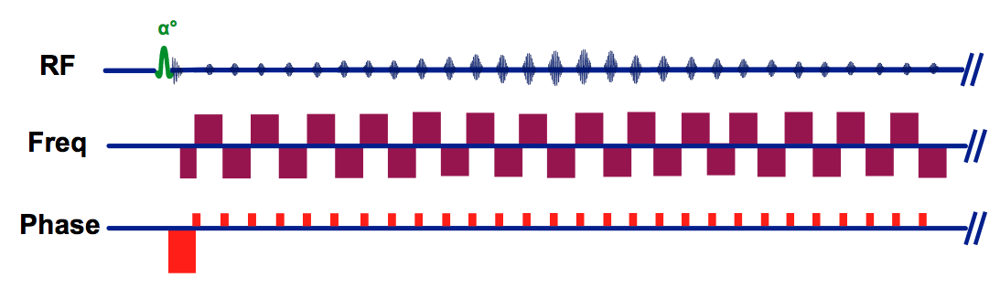

In [4]:
Image(url="https://mriquestions.com/uploads/3/4/5/7/34572113/6084364_orig.png", embed=True)


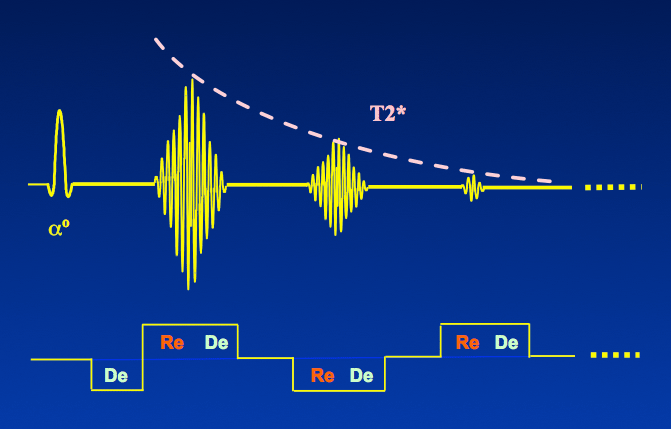

In [11]:
Image(url="https://mriquestions.com/uploads/3/4/5/7/34572113/8854481_orig.gif", embed=True)

## Phase wrap/unwrap consepts

### Simulated data

In [17]:
# Define the T2* value
T2_star = 30  # ms

# Define the time values
time_values = np.linspace(0, 100, 1000) 

# Define the B0 offsets
b0_offsets = np.linspace(0, 2, 5)  # Examples of B0 offsets

delta_t = np.asarray(np.linspace(0,100,5))

decay_term = np.asarray([np.sin((np.pi/2)* time_values)*np.exp(-time_values / T2_star)
                         * np.exp(-( b0_offsets[i])) for i in range(len(b0_offsets))])
simple_decay = np.asarray([np.exp(-time_values / T2_star)* np.exp(-(b0_offsets[i]))
                           for i in range(len(b0_offsets))])
delta_pi =np.asarray([(b0_offsets[i]/(2*np.pi))* len(delta_t[0:i*20]) for i in range(len(b0_offsets))])

fig = make_subplots(rows=2, cols=1, row_heights=[0.5, 0.5], column_widths=[0.6])
for i in range(len(b0_offsets)):
    fig.add_trace(go.Scatter(x= time_values, y= decay_term[i,:], mode='lines', name='FID', visible=False),row=1, col=1)
    fig.add_trace(go.Scatter(x= time_values, y= simple_decay[i,:], marker=dict(color='red'),
                             mode='lines+markers', name='T2* curve', visible=False), row=1, col=1)
    fig.add_trace(go.Scatter(x= delta_t , y= delta_pi[0:i+1], marker=dict(color='green'), name='Phase accural', visible=False), row=2, col=1)

fig.data[0]['visible']= True 
fig.data[1]['visible']= True   
fig.data[2]['visible']= True  

steps = []
for i,j in zip(range(0,len(fig.data),3), range(5)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],
        label=str(b0_offsets[j]*100)
    )
    step["args"][0]["visible"][i] = True  
    step["args"][0]["visible"][i+1] = True
    step["args"][0]["visible"][i+2] = True
    steps.append(step)
    
sliders = [dict(active =0, currentvalue = {"prefix": "B0 offset (Hz): "}, steps = steps)]
fig.layout.sliders = sliders

fig.update_layout(
    title='FID Curve W/Wo B0 Offset')

fig.update_yaxes(title_text="Signal (a.u.)", row=1, col=1)
fig.update_yaxes(title_text="Phase (rad)", row=2, col=1)
fig.update_xaxes(title_text="Time (ms)", row=2, col=1)

fig.update_yaxes(range=[-1,1.1 ], row=1, col=1)
fig.update_yaxes(range=[0, 2], row=2, col=1)

fig.write_html("FID.html")



In [97]:
IFrame(src='./FID.html', width='100%', height='600px')

In [7]:
def phase_wrap(arr):

    phase_range= (-np.pi, np.pi)
    phase_min, phase_max = phase_range
    
    # Wrap the phase values within the specified range
    wrapped_arr = np.mod(arr - phase_min, phase_max - phase_min)
    wrapped_arr += phase_min
    
    return wrapped_arr

x1 = np.arange(0,28,1)
y1 = np.arange(0,28,1)


y2 = phase_wrap(x1)
x2 = [x1[:4], x1[4:10], x1[10:16], x1[16:22], x1[22:28]]
unwraps = [y1[:4], y1[4:10], y1[10:16], y1[16:22], y1[22:28]]

y1_upper= []
y1_lower =[]
u = 0
for num in range(len(y1)):
    y = y1[num]
    y1_lower.append(y-u)
    y1_upper.append(y+u)
    u = y-0.9*y


fig = go.Figure()

for i in range(5):
    fig.add_trace(go.Scatter(x= x2[i], y= unwraps[i],
    fill=None,
    mode='lines',
    name='Correct phase',
    line_color='green', visible= False,
    ))

fig.add_trace(go.Scatter(
x= x1, y= y2,
marker=dict(color='red'),
name='Wrapped phase', visible= True, mode='lines+markers'
))

fig.add_trace(go.Scatter(x = x1, y = y1_lower,
    fill= None,
    mode='lines',
    line_color='rgb(111, 231, 219)', visible= True, 
    ))
fig.add_trace(go.Scatter(
    x= x1,
    y= y1_upper,
    fill='tonexty', # fill area between this trace and previous one 
    mode='lines', line_color='rgb(111, 231, 219)',visible= True, name = 'Expected phase'
))



fig.add_shape(type='line',
              x0= 0, y0= -np.pi, y1= -np.pi, x1= max(x1),
              line=dict(color='red', width=1, dash='dash'),visible= True, 
              )

fig.add_shape(type='line',
              x0= 0, y0= np.pi, y1= np.pi, x1= max(x1),
              line=dict(color='red', width=1, dash='dash'),visible= True, 
              )


labels = ['0' ,'2π','4π','6π', '8π']
steps = []

for i in range(5):
    step = dict(
        method = 'restyle',  
        args = [{'visible': [False]* 8, 'showlegend':[False]* 8 }],
        label = str(labels[i]))
    
    
    step['args'][0]['visible'][i] = True  # Show the current trace
    step['args'][0]['visible'][i-1] = True 
    step['args'][0]['visible'][i-2] = True
    step['args'][0]['visible'][i-3] = True
    step['args'][0]['visible'][5] = True
    step['args'][0]['visible'][6] = True
    step['args'][0]['visible'][7] = True
    
    step['args'][0]['showlegend'][i] = True 
    step['args'][0]['showlegend'][5] = True 
    step['args'][0]['showlegend'][7] = True 

    
    steps.append(step)

sliders = [dict(active =0, currentvalue = {"prefix": "unwrap: "}, steps = steps)]
fig.layout.sliders = sliders

fig.update_layout(xaxis_title='time')
fig.update_layout(yaxis_title='Phase (rad)', yaxis_tickformat='.2f rad',
                  title ="Phase evolution in time")
fig.update_yaxes(tickformat='.2fπ', tickvals= [-1 * np.pi, 0, np.pi, 2*np.pi,4*np.pi, 6*np.pi,8*np.pi, 10*np.pi],
                 ticktext=['-π', '0', 'π', '2π','4π','6π', '8π', '10π'])

fig.show()

fig.write_html("phase_evolution.html")

In [6]:
fig.write_html("phase_evolution.html")
IFrame(src='./Phase_evolution.html', width='100%', height='600px')

### In-vivo data

In [18]:

path = os.getcwd()
data = []
echo_times_4 = []
for i in range(1,5):
    data.append(read_nii(os.path.join(path, "Multi_echo_GRE_data/"+"BR_e"+str(i)+"_ph.nii"))[2])
    json_dic = json.load(open(os.path.join(path, "Multi_echo_GRE_data/"+ "BR_e"+str(i)+"_ph.json")))
    echo_times_4.append(json_dic["EchoTime"])

mag1 = read_nii(os.path.join(path,"Multi_echo_GRE_data/"+"BR_e1_M.nii"))[2]


n_echoes= len(data)
merged_phases = np.stack(data, axis=3)
new_mag = np.repeat(mag1[..., np.newaxis], n_echoes, axis=3)
mask1 = mask_threshold(new_mag, thr= 0.05 * (mag1.max() - mag1.min()))

echotimes = [echo*1000 for echo in echo_times_4] # converting to ms

Lower_slice = merged_phases[...,45,:] * np.squeeze(mask1[...,45,:]) 
Upper_slice = merged_phases[...,55,:] * np.squeeze(mask1[...,50,:]) 

pro_RL1 = [Lower_slice[:,27,i] for i in range(Lower_slice.shape[2])]
pro_AP1 = [Lower_slice[27,:,i] for i in range(Lower_slice.shape[2])]
pro_RL2 = [Upper_slice[:,27,i] for i in range(Lower_slice.shape[2])]
pro_AP2 = [Upper_slice[27,:,i] for i in range(Lower_slice.shape[2])]
xAxis  = Lower_slice.shape[0]
yAxis = Lower_slice.shape[1]

x = np.arange(xAxis)
y = np.ones_like(x)*27


In [124]:

img = make_subplots(rows=3, cols=2, 
                    column_titles= ['Lower slice','Upper slice'], row_heights=[0.6, 0.2, 0.2])
for step in np.arange(0, 4, 1):
    img.add_trace(go.Heatmap(z = Lower_slice[...,step].T,
                             x = list(range(0, xAxis)),
                             y = list(range(0, yAxis)),
                             colorscale='Greys', name = 'phaseVal', visible=False),
                             row=1, col=1)
    img.add_trace(go.Heatmap(z = Upper_slice[...,step].T,
                             x = list(range(0, xAxis)),
                             y = list(range(0, yAxis)),
                             colorscale='Greys', name = 'phaseVal', visible=False),
                             row=1, col=2)
    img.add_scatter(y = np.flip(pro_AP1[step]), row=2 , col=1, visible= False, name = 'phaseVal')
    img.add_scatter(y = np.flip(pro_AP2[step]), row=2 , col=2, visible= False, name = 'phaseVal')
    img.add_scatter(y = pro_RL1[step], row=3 , col=1, visible= False, name = 'phaseVal')
    img.add_scatter(y = pro_RL2[step], row=3 , col=2, visible= False, name = 'phaseVal')
    
img.add_trace(go.Scatter(x = x, y = y,
    fill= None,
    mode='lines',
    line_color='red', visible= True, 
    ), row=1, col=1)

img.add_trace(go.Scatter(x = x, y = y,
    fill= None,
    mode='lines',
    line_color='red', visible= True, 
    ), row=1, col=2)

img.add_trace(go.Scatter(x = y, y = x,
    fill= None,
    mode='lines',
    line_color='red', visible= True, 
    ), row=1, col= 1)

img.add_trace(go.Scatter(x = y, y = x,
    fill= None,
    mode='lines',
    line_color='red', visible= True, 
    ), row=1, col= 2)

img.data[0]['visible'] = True
img.data[1]['visible'] = True
img.data[2]['visible'] = True
img.data[3]['visible'] = True
img.data[4]['visible'] = True
img.data[5]['visible'] = True

steps = []
for i, j in zip(range(0, len(img.data), 6), range(4)):
    step = dict(
        method = 'restyle',  
        args = ['visible', [False] * len(img.data)], label = str(echotimes[j]))
    step['args'][1][i] = True
    step['args'][1][i+1] = True
    step['args'][1][i+2] = True
    step['args'][1][i+3] = True
    step['args'][1][i+4] = True
    step['args'][1][i+5] = True
    step['args'][1][24] = True
    step['args'][1][25] = True
    step['args'][1][26] = True
    step['args'][1][27] = True
    steps.append(step)

sliders = [dict(active =0, currentvalue = {"prefix": "Echo time: ", "suffix":" ms" },steps = steps)]

img.layout.sliders = sliders
img.update_yaxes(title_text="Phase map", row=1, col=1)
img.update_yaxes(title_text="AP projection", row=2, col=1)
img.update_yaxes(title_text="RL projection", row=3, col=1)
img.update_layout(height=800, width=800, showlegend=False, template='plotly_white', )
img.show()

# img.write_html("phase_wraps.html")


In [23]:
# IFrame(src='./phase_wraps.html', width='100%', height='600px')

## Dual-echo field mapping

### OpenNeuro_dataset

In [ ]:
##  Clonning data set from Open neuro website using datalad

# dl.clone(source='https://github.com/OpenNeuroDatasets/ds001600.git')

The field offset can be calculated based on phase difference between the two images with different echo times as following.
$$\Delta B_0 = \frac{Δφ}{\Delta TE.2π} $$

In [4]:

layout = BIDSLayout('ds001600')

Phases_path=[]
jsons_path =[]
mags_path = []
echo_times= []

for i in range(1,3):
    Phase_path = layout.get(acquisition= 'v'+str(i),
                                datatype = 'fmap',
                                extension = 'nii.gz',
                                suffix= 'phase'+str(i))
        
    mag_path = layout.get(acquisition= 'v'+str(i),
                           datatype = 'fmap',
                           extension = '.nii.gz',
                           fmap = 'magnitude'+str(i),
                          suffix= 'magnitude'+str(i))
    
    json_path = layout.get(acquisition= 'v'+str(i),
                           extension = '.json',
                           suffix= 'phase'+str(i))
    
    mags_path.append(re.findall(r"'([^']*)'", str(mag_path)))
    Phases_path.append(re.findall(r"'([^']*)'", str(Phase_path)))
    jsons_path.append(re.findall(r"'([^']*)'", str(json_path)))

    dic = json.load(open(jsons_path[i-1][0]))
    echo_times.append(dic['EchoTime'])
    
    
echo_time_diff = echo_times[1]-echo_times[0]  
mag2 = nib.load(mags_path[0][0]).get_fdata()
phase_nii = nib.load(Phases_path[0][0])
phase1 = phase_nii.get_fdata()
phase2 = nib.load(Phases_path[1][0]).get_fdata()
mask2 = mask_threshold(mag2, thr= 0.05 * (mag2.max() - mag2.min()))

phase1 = (((phase1 - np.min(phase1))/(np.max(phase1)-np.min(phase1)))*2*np.pi -np.pi) *mask2
phase2 = (((phase2 - np.min(phase2))/(np.max(phase2)-np.min(phase2)))*2*np.pi -np.pi) *mask2

comp1 = np.exp(1j * phase1)
comp2 = np.exp(1j * phase2)

phase_diff_con = np.angle(comp2*np.conjugate(comp1))

phase_diff_nii = nib.Nifti1Image(phase_diff_con, phase_nii.affine, phase_nii.header)
nib.save(phase_diff_nii, 'phase_complex_diff')



In [5]:
# Unwrapping takes a few minutes! Do not run unwrapping comand each time! instead load the already saved one. 


# unwraped_phase_diff = unwrap_phase(phase_diff_nii, unwrapper= 'prelude', mag= mag2, mask= mask2)
# print(type(phase_diff_nii))

# print(phase_diff_nii.shape)
# unwraped_phase_diff_nii = nib.Nifti1Image(unwraped_phase_diff, phase_nii.affine, phase_nii.header)
# nib.save(unwraped_phase_diff_nii, 'unwraped_phase_diff')


unwraped_phase_diff= nib.load('unwraped_phase_diff.nii').get_fdata()

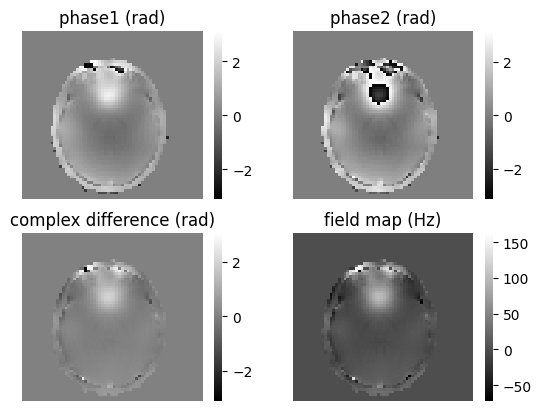

In [41]:

delta_te = (echo_times[1] - echo_times[0])
field_map1 = (unwraped_phase_diff/(2*np.pi*delta_te))*mask2  # [Hz]


plt.subplot(2,2,1)
sns.heatmap(np.rot90(phase1[...,20], k=1), cmap='gray', xticklabels=False, yticklabels=False), plt.title('phase1 (rad)'), 
plt.subplot(2,2,2)
sns.heatmap(np.rot90(phase2[...,20], k=1), cmap='gray',  xticklabels=False, yticklabels=False), plt.title('phase2 (rad)')
plt.subplot(2,2,3)
sns.heatmap(np.rot90(phase_diff_con[...,20], k=1), cmap='gray', xticklabels=False, yticklabels=False), plt.title('complex difference (rad)')
plt.subplot(2,2,4)
sns.heatmap(np.rot90(field_map1[...,20], k=1), cmap='gray', xticklabels=False, yticklabels=False), plt.title('field map (Hz)'), plt.colorbar

(field_map1.shape)[2]

plt.savefig('double_echo.png')

### 3d plotting function

In [13]:

def show_3D(vol):
    ## vol is the 3d volume. input

    volume = vol.T
    r, c = volume[0].shape

    # Define frames

    nb_frames = (vol.shape)[2]

    fig = go.Figure(frames=[go.Frame(data=go.Surface(
        z=(((nb_frames-1)*0.1) - (k * 0.1)) * np.ones((r, c)),
        surfacecolor=np.flipud(volume[nb_frames-1 - k]),
        cmin=np.min(vol), cmax=np.max(vol)
        ),
        name=str(k) # you need to name the frame for the animation to behave properly
        )
        for k in range(nb_frames)])

    # Add data to be displayed before animation starts
    fig.add_trace(go.Surface(
        z= ((nb_frames-1)*0.1) * np.ones((r, c)),
        surfacecolor=np.flipud(volume[0]),
        colorscale='Gray',
        cmin=np.min(vol), cmax=np.max(vol),

        colorbar=dict(thickness=20, ticklen=4)
        ))


    def frame_args(duration):
        return {
                "frame": {"duration": duration},
                "mode": "immediate",
                "fromcurrent": True,
                "transition": {"duration": duration, "easing": "linear"},
            }

    sliders = [
                {
                    "pad": {"b": 10, "t": 60},
                    "len": 0.9,
                    "x": 0.1,
                    "y": 0,
                    "steps": [
                        {
                            "args": [[f.name], frame_args(0)],
                            "label": str(k),
                            "method": "animate",
                        }
                        for k, f in enumerate(fig.frames)
                    ],
                }
            ]

    # Layout
    fig.update_layout(
             title='3D volume',
             width=600,
             height=600,
             scene=dict(
                        zaxis=dict(range=[-0.1, 4.4], autorange=False),
                        aspectratio=dict(x=1, y=1, z=1),
                        ),
             updatemenus = [
                {
                    "buttons": [
                        {
                            "args": [None, frame_args(50)],
                            "label": "&#9654;", # play symbol
                            "method": "animate",
                        },
                        {
                            "args": [[None], frame_args(0)],
                            "label": "&#9724;", # pause symbol
                            "method": "animate",
                        },
                    ],
                    "direction": "left",
                    "pad": {"r": 10, "t": 70},
                    "type": "buttons",
                    "x": 0.1,
                    "y": 0,
                }
             ],
             sliders=sliders
    )
    
    fig.write_html("fieldmap_1.html")
    return fig.show()

In [14]:
show_3D(field_map1)

## Multi-echo field mapping

### Neuropoly dataset

In [16]:
## Unwrapping takes a few minutes! Do not run unwrapping comand each time! instead load the already saved one. 
path = os.getcwd()
mag1 = read_nii(os.path.join(path,"Multi_echo_GRE_data/"+"BR_e1_M.nii"))[2]
phase_list_nii = [nib.load(os.path.join(path, "Multi_echo_GRE_data/"+"BR_e"+str(i)+"_ph.nii")) for i in range(1,5)]
phase_list_data = [phase_list_nii[i].get_fdata() for i in range(len(phase_list_nii))]

scaled_phase_list_data = [((phase_list_data[i] - np.min(phase_list_data[i]))/(np.max(phase_list_data[i])-np.min(phase_list_data[i])))
                         *2*np.pi-np.pi for i in range(len(phase_list_data))]


scaled_phase_list_nii = [nib.Nifti1Image(scaled_phase_list_data[i], phase_list_nii[0].affine, phase_list_nii[0].header)
                         for i in range(len(scaled_phase_list_data))]

mask3 = mask_threshold(mag1, thr= 0.05 * (mag1.max() - mag1.min()))

# unwraped_phase_list_data = [unwrap_phase(scaled_phase_list_nii[i], unwrapper = 'prelude', mag=mag, mask=mask3)
#                        for i in range(len(scaled_phase_list_nii))]

# unwraped_phase_list_nii = [nib.Nifti1Image(unwraped_phase_list_data[i], phase_list_nii[0].affine, phase_list_nii[0].header)
#                            for i in range(len(unwraped_phase_list_data))]

# unwrap_phase1 = nib.save(unwraped_phase_list_nii[0], 'unwrap_phase1')
# unwrap_phase2 = nib.save(unwraped_phase_list_nii[1], 'unwrap_phase2')
# unwrap_phase3 = nib.save(unwraped_phase_list_nii[2], 'unwrap_phase3')
# unwrap_phase4 = nib.save(unwraped_phase_list_nii[3], 'unwrap_phase4')


unwrap_phase1 = nib.load('unwrap_phase1.nii').get_fdata()
unwrap_phase2 = nib.load('unwrap_phase2.nii').get_fdata()
unwrap_phase3 = nib.load('unwrap_phase3.nii').get_fdata()
unwrap_phase4 = nib.load('unwrap_phase4.nii').get_fdata()

unwraped_phase_list_data = [unwrap_phase1, unwrap_phase2, unwrap_phase3, unwrap_phase4]


[-0.00018265098333358765, -1.3753771781921387e-05, -7.728580385446548e-05, -1.946813426911831e-06]


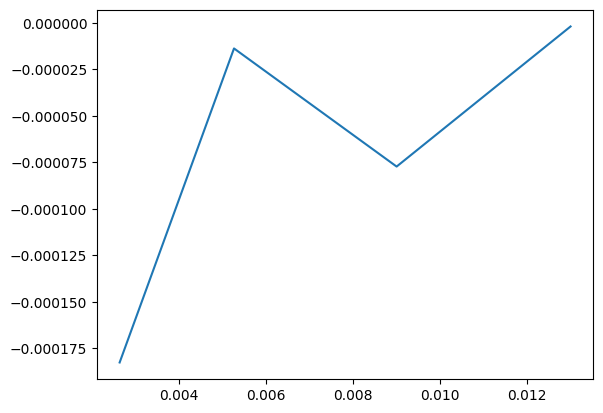

In [19]:
mask_list = [np.ma.array(unwraped_phase_list_data[i], mask=mask3) for i in range(len(unwraped_phase_list_data))]
mean_list = [np.ma.mean(mask_list[i]) for i in range(len(mask_list))]
print(mean_list)
plt.plot(echo_times_4, mean_list)

(<matplotlib.image.AxesImage at 0x12a5b1610>,
 Text(0.5, 1.0, 'unwraped_diff'))

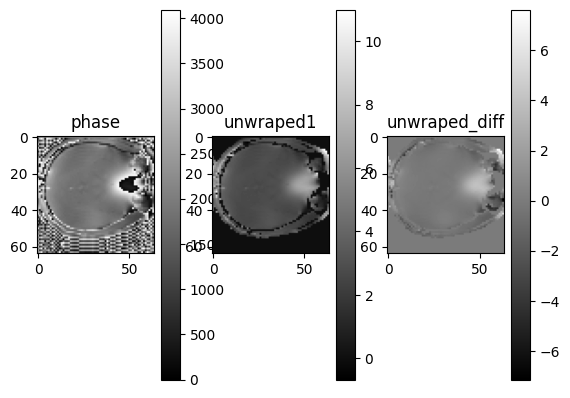

In [24]:
comp_1 = np.exp(1j * scaled_phase_list_data[0])
comp_2 = np.exp(1j * scaled_phase_list_data[1])

phase_diff_multi = np.angle(comp_2* np.conjugate(comp_1))

phase_diff_multi_nii = nib.Nifti1Image(phase_diff_multi, phase_list_nii[0].affine, phase_list_nii[0].header)
unwraped_phase_diff_multi = unwrap_phase(phase_diff_multi_nii, unwrapper = 'prelude', mag=mag1, mask=mask3)

unwraped_phase_diff_multi_nii = nib.Nifti1Image(unwraped_phase_diff_multi, phase_list_nii[0].affine, phase_list_nii[0].header)
nib.save(unwraped_phase_diff_multi_nii, 'unwraped_phase_diff_multi')

plt.subplot(1,3,1)
plt.imshow(phase_list_data[0][...,42], cmap='gray'), plt.colorbar(), plt.title('phase')
plt.subplot(1,3,2)
plt.imshow(unwrap_phase1[...,42], cmap='gray'), plt.colorbar(), plt.title('unwraped1')
plt.subplot(1,3,3)
plt.imshow(unwraped_phase_diff_multi[...,42], cmap='gray'), plt.colorbar(), plt.title('unwraped_diff')



In [25]:
unwraped_phase_diff_multi = nib.load('unwraped_phase_diff_multi.nii').get_fdata()

initial_slope = unwraped_phase_diff_multi/((echo_times_4[1] - echo_times_4[0])) # [rad/s]


# plt.imshow(initial_slope[...,42], cmap='gray'), plt.colorbar()


In [26]:

# multiplying echo time as x by initial slope corrects for n*2*pi offset in time [y2 = slope(x2-x1)+y1]
previous_phase = (initial_slope*(echo_times_4[1]))+ unwrap_phase1 # time corrected phase of second echo 
# n is an array of numbers for correcting 2pi offsets 
n = np.arange(1,20)
reshaped_initial_slope = initial_slope.reshape(-1,1).T
reshaped_previous_phase = previous_phase.reshape(-1,1).T
reshaped_mask = mask3.reshape(-1,1).T
offset = 1e-6
counter_v = []
counter_n = []
for echo in range(2,4):
    new_reshaped_phase = (scaled_phase_list_data[echo]*mask3).reshape(-1,1).T
    reshaped_phases = np.concatenate((reshaped_previous_phase, new_reshaped_phase), axis=0)
    x_val = echo_times_4[echo]
    
    for voxel in range(len(reshaped_phases[1])):
        if reshaped_mask[0,voxel]>0:
            counter_v.append(voxel)
            for num in n:
                counter_n.append(num)
                slope = reshaped_initial_slope[0, voxel]
                if slope>0:
                    estimated_phase = reshaped_phases[echo-1, voxel] + num *2* np.pi
                    expected_phase = (slope * x_val)+ reshaped_previous_phase[0, voxel]
                    if (expected_phase - (offset*slope)) < estimated_phase < (expected_phase + (offset* slope)):
                        reshaped_phases[echo-1, voxel] += num *2* np.pi
                        break
                else:
                    estimated_phase = reshaped_phases[echo-1, voxel] - num *2* np.pi
                    expected_phase = (slope * x_val)+ reshaped_previous_phase[0, voxel]
                    if (expected_phase - (offset*slope)) < expected_phase < (expected_phase + (offset* slope)):
                        reshaped_phases[echo-1, voxel] -= num *2* np.pi
                        break        
#     offset += offset
        
    reshaped_previous_phase = reshaped_phases



In [27]:
X = np.asarray([echo_times_4[1], echo_times_4[2], echo_times_4[3]])
# np.shape(X.reshape(-1, 1))

reg = LinearRegression().fit(X.reshape(-1, 1), reshaped_phases)
# # Slope of linear regression reshaped into the shape of original 3D phase.
new_slope = reg.coef_.reshape(unwrap_phase1.shape)  # the initial slope in [rad / s]
new_slope.shape

(64, 64, 100)

(<matplotlib.image.AxesImage at 0x12b8ec990>,
 <matplotlib.colorbar.Colorbar at 0x12ac363d0>)

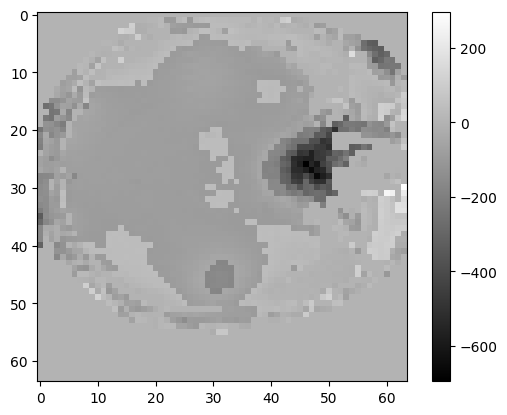

In [28]:
new_fieldmap = new_slope/(2*np.pi)


# new_fieldmap_nii = nib.Nifti1Image(new_fieldmap, phase_list_nii[0].affine, phase_list_nii[0].header)
# nib.save(new_fieldmap_nii, 'new_fieldmap')


plt.imshow(new_fieldmap[...,37], cmap='gray'), plt.colorbar()

# show_3D(new_fieldmap)

In [59]:

## Running this code returns one tuple including fieldmap and mask volumes respectively.

# st_fieldmap = prepare_fieldmap(scaled_phase_list_nii, echo_times_4, mag1, unwrapper='prelude', mask=mask3)
# st_fieldmap_nii = nib.Nifti1Image(st_fieldmap[0], phase_list_nii[0].affine, phase_list_nii[0].header)
# nib.save(st_fieldmap_nii, 'st_fieldmap')

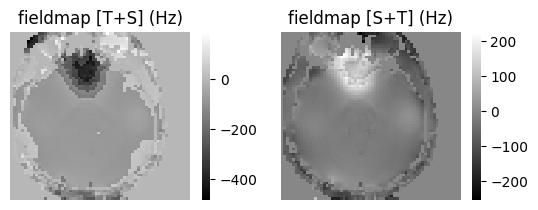

In [45]:
st_fieldmap2 = nib.load('st_fieldmap.nii').get_fdata()

plt.subplot(2,2,1)
sns.heatmap(np.rot90(new_fieldmap[...,40], k=1), cmap='gray', xticklabels=False, yticklabels=False), plt.title('fieldmap [T+S] (Hz)'), 
plt.subplot(2,2,2)
sns.heatmap(np.rot90(st_fieldmap2[...,40], k=1), cmap='gray',  xticklabels=False, yticklabels=False), plt.title('fieldmap [S+T] (Hz)')
plt.savefig('linear_fitting.png')

## EPI fieldmapping

In [60]:

layout = BIDSLayout('ds001600')

EPI_AP_nii_path = layout.get(acquisition= 'AP',
                            datatype = 'func',
                            extension = 'nii.gz',
                            )

EPI_AP_json_path = layout.get(acquisition= 'AP',
                            datatype = 'func',
                            extension = '.json',
                            )

EPI_PA_nii_path = layout.get(direction= 'PA',
                            datatype = 'fmap',
                            extension = 'nii.gz',
                            suffix= 'epi')
EPI_PA_json_path = layout.get(direction= 'PA',
                            datatype = 'fmap',
                            extension = '.json',
                            suffix= 'epi')
# print(EPI_AP_json_path)
# EPI_AP_json_path[0].get_entities()

# Total Readout Time
dic = json.load(open(EPI_AP_json_path[0]))

TotalReadoutTime = (dic['TotalReadoutTime'])


EPI_AP_nii_path = re.findall(r"'([^']*)'", str(EPI_AP_nii_path))
EPI_PA_nii_path = re.findall(r"'([^']*)'", str(EPI_PA_nii_path))

EPI_AP_nii = nib.load(EPI_AP_nii_path[0])
EPI_PA_nii = nib.load(EPI_PA_nii_path[0])

EPI_AP_1 = EPI_AP_nii.get_fdata()[...,0]

EPI_PA_nii = nib.load(EPI_PA_nii_path[0])

EPI_PA_1 = EPI_PA_nii.get_fdata()[...,0]


EPI_PA_1_nii = nib.Nifti1Image(EPI_PA_1, EPI_PA_nii.affine, EPI_PA_nii.header)
EPI_AP_1_nii = nib.Nifti1Image(EPI_AP_1, EPI_AP_nii.affine, EPI_AP_nii.header)

nib.save(EPI_PA_1_nii, 'EPI_PA')
nib.save(EPI_AP_1_nii, 'EPI_AP')

# print(type(EPI_AP))
# print(EPI_AP_nii)
# print(EPI_PA.shape)
mask2 = mask_threshold(mag2, thr= 0.05 * (mag2.max() - mag2.min()))

In [27]:

# !fslmerge -t merged_EPIs.nii EPI_AP.nii EPI_PA.nii

In [33]:

# Acqusition_info = [0,-1,0,TotalReadoutTime,0,1,0, TotalReadoutTime]

# file = open("Acqusition_info.txt", "w+")
 
# # Saving the array in a text file
# content = str(Acqusition_info)
# file.write(content)
# file.close()

In [38]:
# !topup --imain=merged_EPIs.nii --datain=Acqusition_info.txt --config=b02b0.cnf --fout=FSL_fieldmap_Hz2 --iout=Corrected_EPI


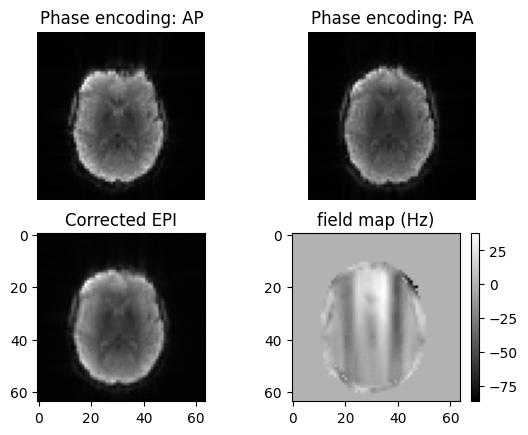

In [64]:
Corrected_EPI = nib.load('Corrected_EPI.nii.gz').get_fdata()
FSL_fieldmap_Hz2 = nib.load('FSL_fieldmap_Hz2.nii.gz').get_fdata()

FSL_fieldmap_Hz2.shape
plt.subplot(2,2,1,) 
plt.imshow(np.rot90(EPI_AP_1[...,22], k=1), cmap='gray'), plt.title('Phase encoding: AP'),plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(np.rot90(EPI_PA_1[...,22], k=1) , cmap='gray'), plt.title('Phase encoding: PA'), plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(np.rot90(Corrected_EPI[...,22,0], k=1) , cmap='gray'), plt.title('Corrected EPI')

plt.subplot(2,2,4)
plt.imshow(np.rot90(FSL_fieldmap_Hz2[...,22]*mask2[...,22], k=1) , cmap='gray'), plt.title('field map (Hz)'), plt.colorbar()
plt.savefig("PE_EPI.png")



## rs-fMRI correction

### Data_preperation

In [65]:
# ##  Clonning data set from Open neuro website using datalad

# dl.clone(source='https://github.com/OpenNeuroDatasets/ds000172.git')
dataset_path = os.path.join(os.getcwd(),'ds000172', 'sub-control02') 
dl.get(dataset_path)


INFO:datalad.annex:Start annex operation
INFO:datalad.annex:Finished annex get
INFO:datalad:Clear progress bars
INFO:datalad:Refresh progress bars
INFO:datalad:Clear progress bars
INFO:datalad:Refresh progress bars
INFO:datalad:Clear progress bars
INFO:datalad:Refresh progress bars


get(error): ds000172/sub-control02/fmap/sub-control02_magnitude1.nii.gz (file) [not available; (Note that these git remotes have annex-ignore set: origin)]
get(impossible): ds000172/sub-control02 (directory) [could not get some content in /Users/behrouz/Vejdani_project/ds000172/sub-control02 ['/Users/behrouz/Vejdani_project/ds000172/sub-control02/fmap/sub-control02_magnitude1.nii.gz']]
action summary:
  get (error: 1, impossible: 1)


IncompleteResultsError: Command did not complete successfully. 2 failed:
[{'action': 'get',
  'annexkey': 'MD5E-s687721--4a18db568fef2ae16c02042d6e6e3a75.nii.gz',
  'message': 'not available; (Note that these git remotes have annex-ignore '
             'set: origin)',
  'path': '/Users/behrouz/Vejdani_project/ds000172/sub-control02/fmap/sub-control02_magnitude1.nii.gz',
  'refds': '/Users/behrouz/Vejdani_project',
  'status': 'error',
  'type': 'file'},
 {'action': 'get',
  'message': ('could not get some content in %s %s',
              '/Users/behrouz/Vejdani_project/ds000172/sub-control02',
              ['/Users/behrouz/Vejdani_project/ds000172/sub-control02/fmap/sub-control02_magnitude1.nii.gz']),
  'path': '/Users/behrouz/Vejdani_project/ds000172/sub-control02',
  'refds': '/Users/behrouz/Vejdani_project',
  'status': 'impossible',
  'type': 'directory'}]

In [66]:
Layout = BIDSLayout('ds000172')

phasediff_nii_path = Layout.get(subject= 'control02',
                             suffix= 'phasediff',
                            datatype = 'fmap',
                            extension = 'nii.gz',
                            )

phasediff_json_path = Layout.get(subject= 'control02',
                            datatype = 'fmap',
                            extension = '.json',
                            suffix= 'phasediff')

Magnitude_nii_path = Layout.get(subject= 'control02',
                             suffix= 'magnitude2',
                            datatype = 'fmap',
                            extension = 'nii.gz',
                            )
Bold_nii_path = Layout.get(subject= 'control02',
                            task= 'rest',
                            acquisition= 'voxelsize333',
                            suffix = 'bold',
                            extension = 'nii.gz',
                            )

Bold_json_path = Layout.get(subject= 'control02',
                            acquisition= 'voxelsize333',
                            suffix = 'bold',
                            extension = '.json',
                            )

T1_path = Layout.get(subject= 'control02',
                            suffix= 'T1w',
                            datatype = 'anat',
                            extension = '.nii.gz',
                            )

phasediff_nii_path = re.findall(r"'([^']*)'", str(phasediff_nii_path))
Magnitude_nii_path = re.findall(r"'([^']*)'", str(Magnitude_nii_path))
Bold_nii_path = re.findall(r"'([^']*)'", str(Bold_nii_path))
T1_path = re.findall(r"'([^']*)'", str(T1_path[1]))


Magnitude_nii = nib.load(Magnitude_nii_path[0])
phasediff_nii = nib.load(phasediff_nii_path[0])
Bold_nii = nib.load(Bold_nii_path[0])
T1_nii = nib.load(T1_path[0])

phasediff = phasediff_nii.get_fdata()
Magnitude = Magnitude_nii.get_fdata()
Bold = Bold_nii.get_fdata()
T1= T1_nii.get_fdata()

mask4 = mask_threshold(Magnitude, thr= 0.05 * (Magnitude.max() - Magnitude.min()))
phasediff_scaled = ((phasediff - np.min(phasediff))/(np.max(phasediff)-np.min(phasediff)))*2*np.pi -np.pi

dic1 = json.load(open(phasediff_json_path[0]))
dic2 = json.load(open(Bold_json_path[0]))

TE_1 = (dic1['EchoTime1'])
TE_2 = (dic1['EchoTime2'])

print(Bold.shape)
dwell_time = (dic2['EffectiveEchoSpacing'])

echo_diff = TE_2 - TE_1
fieldmap_3 = (phasediff_scaled/echo_diff)*mask4 # rad/s
fieldmap_3_nii = nib.Nifti1Image(fieldmap_3, phasediff_nii.affine, phasediff_nii.header)

nib.save(fieldmap_3_nii, 'fieldmap_3_nii')
nib.save(Bold_nii,'Bold_v333')

(64, 64, 35, 150)


In [44]:
# Magnitude_nii_path
T1_path[1].get_entities()
# /Users/behrouz/Vejdani_project/ds000172/sub-control02/fmap/sub-control02_phasediff.nii.gz 

{'datatype': 'anat',
 'extension': '.nii.gz',
 'subject': 'control02',
 'suffix': 'T1w'}

In [ ]:
# TO DO THE REGISTRATION
# !flirt -cost normmi -dof 6 -omat /fullpath/T2_coplanar_2_T1.mat -in /fullpath/T2_coplanar.img -ref /fullpath/T1_hires.img -out /fullpath/T2_coplanar_2_T1.im


In [67]:
# file = open("dwell_time.txt", "w+")
 
# # Saving the array in a text file
# content = str(dwell_time)
# file.write(content)
# file.close()
dwell_time

0.00086

### Uncorrected rs-fMRI connectivity analysis

In [75]:
from nilearn.input_data import NiftiMasker

bold_nii = nib.load('Bold_all_2_MNI.nii.gz')
bold = bold_nii.get_fdata()
print(bold.shape)

masker = NiftiMasker()
masked_data = masker.fit_transform(bold_nii)
print(masked_data.shape)
print(type(masked_data))

(91, 109, 91, 150)
(150, 438498)
<class 'numpy.ndarray'>


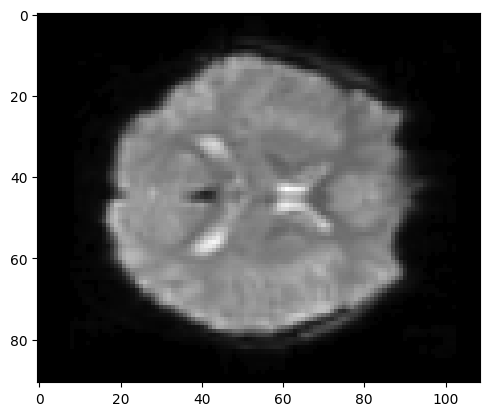

In [76]:
thresholded_masked_data = masked_data * (masked_data > 0.1* masked_data.mean())

thresholded_img = masker.inverse_transform(thresholded_masked_data)

plt.imshow(thresholded_img.get_fdata()[:,:,40,0], cmap='gray')

In [77]:
from nilearn import datasets

data_dir = os.getcwd # change this variable with the path where you want nilearn to download
#                 # the data, if you leave None, the default will be '~/nilearn_data'
    
# # Loading the functional datasets
# data = datasets.fetch_development_fmri(n_subjects=1, data_dir=data_dir)

# # you can use the .keys() method to check what's in the dataset
# data.keys()

In [78]:
atlas_dataset = datasets.fetch_atlas_msdl(data_dir=data_dir)
atlas_filepath = atlas_dataset.maps
labels = atlas_dataset.labels

In [79]:
from nilearn.input_data import NiftiMapsMasker

atlas_masker = NiftiMapsMasker(maps_img= atlas_filepath, standardize=True)
data_in_atlas = atlas_masker.fit_transform(bold_nii)
data_in_atlas.shape

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/joblib/memory.py:349: FutureWarning:

The default strategy for standardize is currently 'zscore' which incorrectly uses population std to calculate sample zscores. The new strategy 'zscore_sample' corrects this behavior by using the sample std. In release 0.13, the default strategy will be replaced by the new strategy and the 'zscore' option will be removed. Please use 'zscore_sample' instead.



(150, 39)

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/nilearn/connectome/connectivity_matrices.py:495: FutureWarning:

The default strategy for standardize is currently 'zscore' which incorrectly uses population std to calculate sample zscores. The new strategy 'zscore_sample' corrects this behavior by using the sample std. In release 0.13, the default strategy will be replaced by the new strategy and the 'zscore' option will be removed. Please use 'zscore_sample' instead.



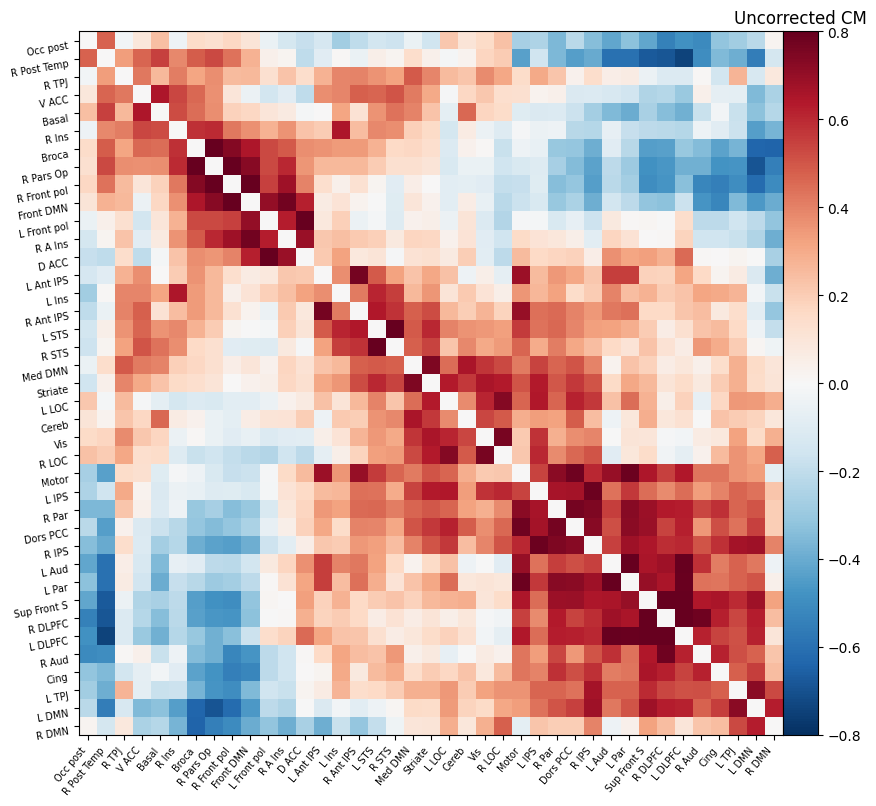

In [81]:
from nilearn.connectome import ConnectivityMeasure
correlation_measure1 = ConnectivityMeasure(kind='correlation')
correlation_matrix1 = correlation_measure1.fit_transform([data_in_atlas])[0]

# Plot the correlation matrix

from nilearn import plotting
# Make a large figure
# Mask the main diagonal for visualization:
np.fill_diagonal(correlation_matrix1, 0)
# The matrix is reordered for block-like representation
plotting.plot_matrix(correlation_matrix1, figure=(10, 8), labels=labels,
                     vmax=0.8, vmin=-0.8, reorder=True), plt.title('Uncorrected CM')

plt.savefig('Uncorrected_CM.png')

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/nilearn/plotting/html_stat_map.py:111: UserWarning:

Threshold given was 1e-06, but the data has no values below 12.0. 

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/numpy/core/fromnumeric.py:784: UserWarning:





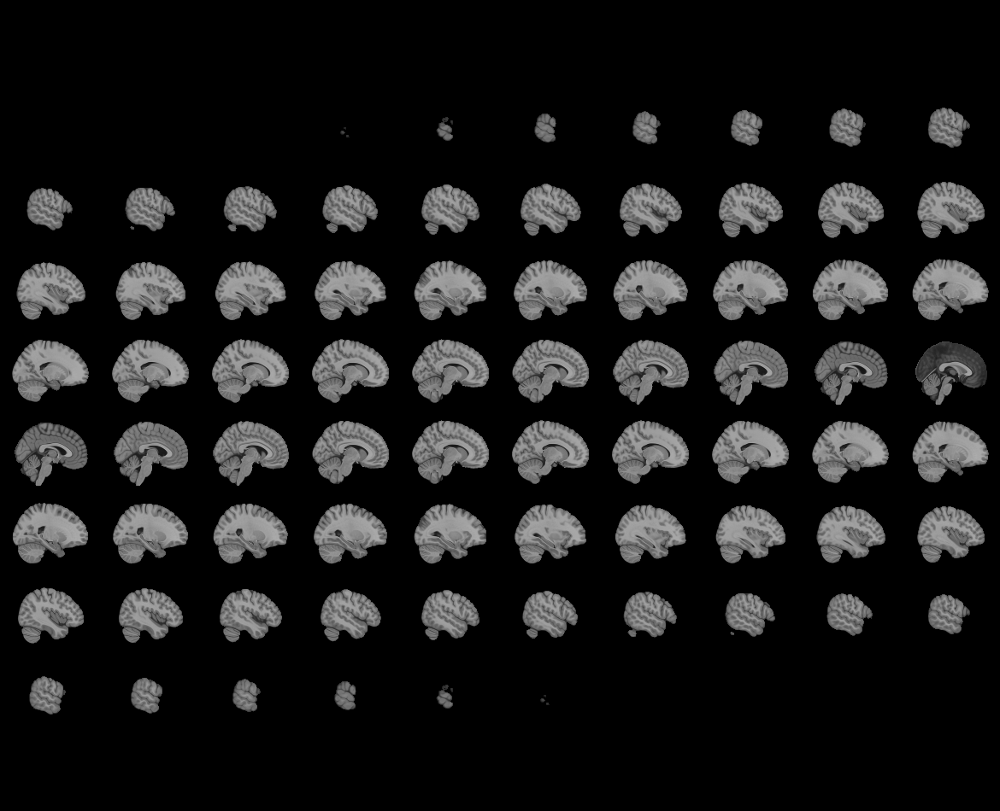
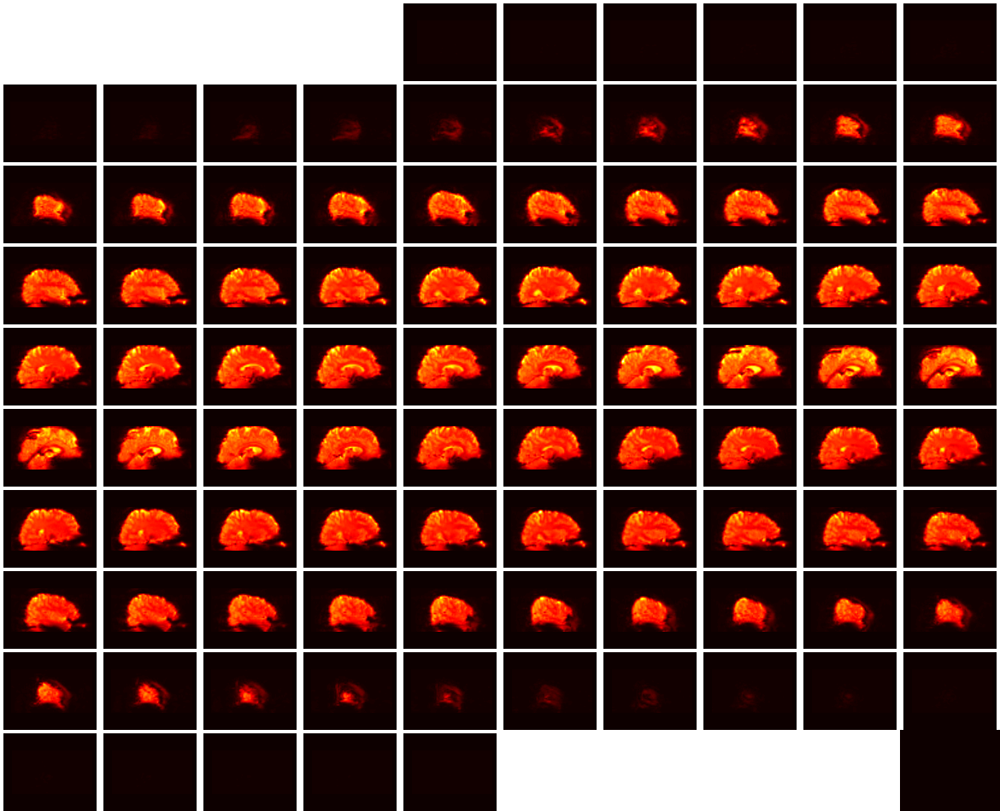

In [87]:
from nilearn.plotting import view_img

# Since our fmri_img is a 4D NiftiImage, we need to generate a 3D one.
# One way of doing that is averaging our volumes on the time axis 
# with the mean_img function.
from nilearn.image.image import mean_img

fmri_img_mean = mean_img(bold_nii)
np.shape(fmri_img_mean)AttributeError: module 'nilearn.plotting' has no attribute 'view_img_to_html'
# view_img(corrected_bold_nii.slicer[...,40])
view_img(fmri_img_mean)



### Corrected rs-fMRI connectivity analysis

In [89]:
# !fugue -i Bold_v333.nii --dwell=0.00086 --loadfmap=fieldmap_3_nii.nii -u corrected_bold_333

In [96]:
from nilearn.input_data import NiftiMasker

corrected_bold_nii = nib.load('coorected_bold_all_2_MNI.nii.gz')
corrected_bold = corrected_bold_nii.get_fdata()
print(corrected_bold.shape)

masker2 = NiftiMasker()
masked_data2 = masker2.fit_transform(corrected_bold_nii)
# print(masked_data2.shape)
# print(type(masked_data2))

(91, 109, 91, 150)


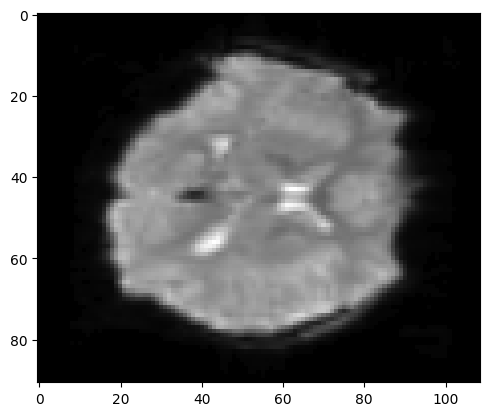

In [97]:
thresholded_masked_data2 = masked_data * (masked_data2 > 0.1* masked_data2.mean())

thresholded_img2 = masker2.inverse_transform(thresholded_masked_data2)

plt.imshow(thresholded_img2.get_fdata()[:,:,40,0], cmap='gray')

In [5]:
from nilearn import datasets

data_dir = os.getcwd # change this variable with the path where you want nilearn to download
                # the data, if you leave None, the default will be '~/nilearn_data'
    
# Loading the functional datasets
data = datasets.fetch_development_fmri(n_subjects=1, data_dir=data_dir)

# you can use the .keys() method to check what's in the dataset
data.keys()

dict_keys(['func', 'confounds', 'phenotypic', 'description'])

In [98]:
atlas_dataset = datasets.fetch_atlas_msdl(data_dir=data_dir)
atlas_filepath = atlas_dataset.maps
labels = atlas_dataset.labels

In [100]:
from nilearn.input_data import NiftiMapsMasker

atlas_masker2 = NiftiMapsMasker(maps_img=atlas_filepath, standardize=True)
data_in_atlas2 = atlas_masker2.fit_transform(corrected_bold_nii)
data_in_atlas2.shape


/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/joblib/memory.py:349: FutureWarning:

The default strategy for standardize is currently 'zscore' which incorrectly uses population std to calculate sample zscores. The new strategy 'zscore_sample' corrects this behavior by using the sample std. In release 0.13, the default strategy will be replaced by the new strategy and the 'zscore' option will be removed. Please use 'zscore_sample' instead.



(150, 39)

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/nilearn/connectome/connectivity_matrices.py:495: FutureWarning:

The default strategy for standardize is currently 'zscore' which incorrectly uses population std to calculate sample zscores. The new strategy 'zscore_sample' corrects this behavior by using the sample std. In release 0.13, the default strategy will be replaced by the new strategy and the 'zscore' option will be removed. Please use 'zscore_sample' instead.



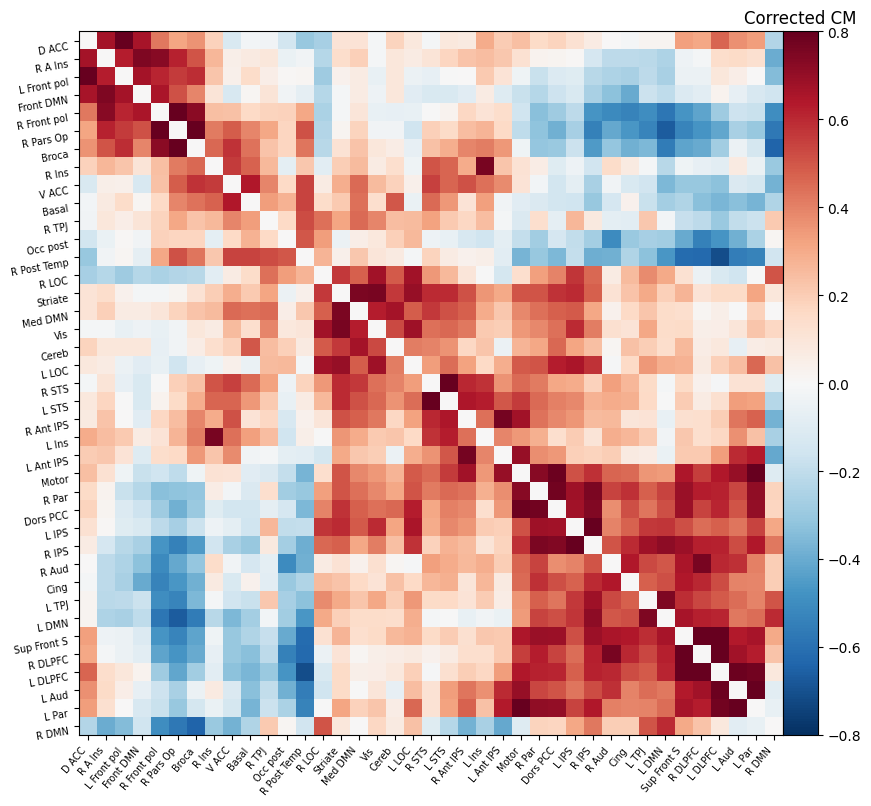

In [101]:
from nilearn.connectome import ConnectivityMeasure
correlation_measure = ConnectivityMeasure(kind='correlation')
correlation_matrix = correlation_measure.fit_transform([data_in_atlas2])[0]

# Plot the correlation matrix
import numpy as np
from nilearn import plotting
# Make a large figure
# Mask the main diagonal for visualization:
np.fill_diagonal(correlation_matrix, 0)
# The matrix is reordered for block-like representation
plotting.plot_matrix(correlation_matrix, figure=(10, 8), labels=labels,
                     vmax=0.8, vmin=-0.8, reorder=True), plt.title('Corrected CM')

plt.savefig('Corrected_CM.png')

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/numpy/core/fromnumeric.py:784: UserWarning:





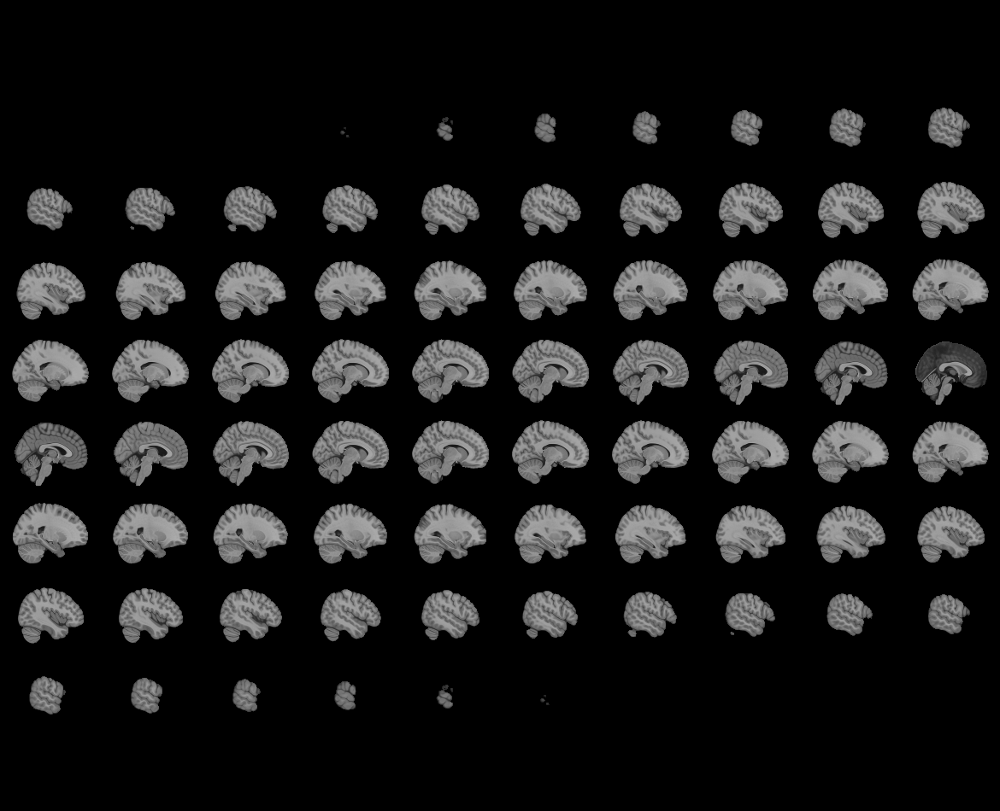
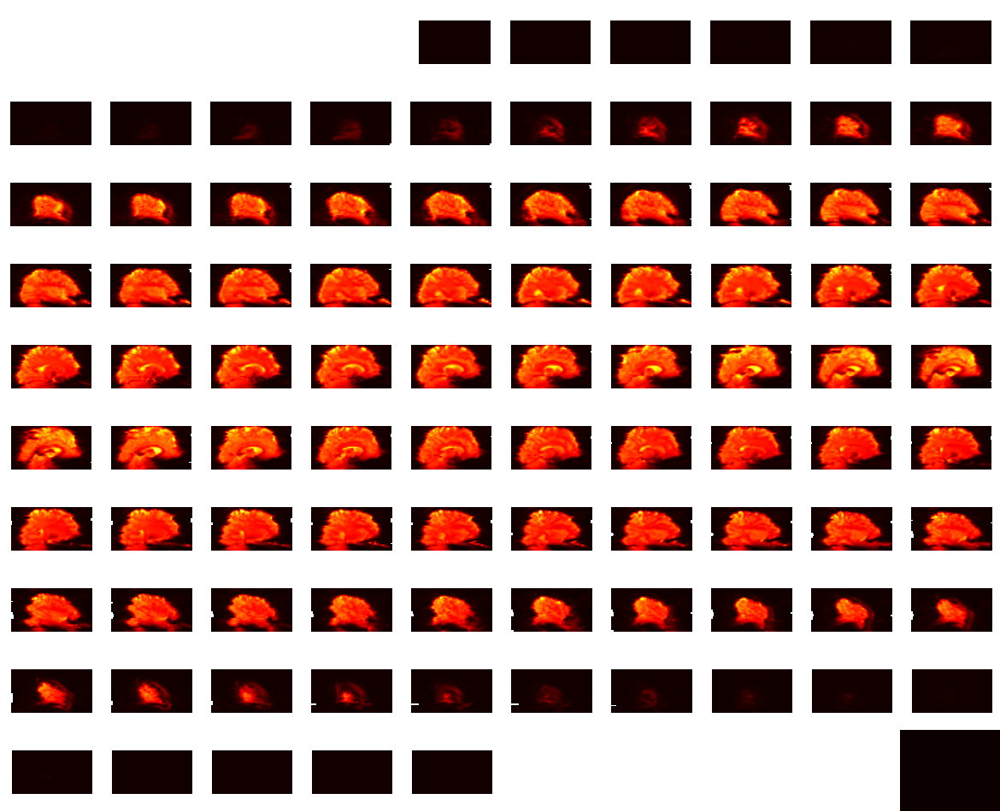

In [102]:
from nilearn.plotting import view_img
from nilearn.image.image import mean_img
# Since our fmri_img is a 4D NiftiImage, we need to generate a 3D one.
# One way of doing that is averaging our volumes on the time axis 
# with the mean_img function.


fmri_img_mean = mean_img(corrected_bold_nii)
np.shape(fmri_img_mean)

view_img(fmri_img_mean)

/Users/behrouz/miniconda3/envs/brain_hack/lib/python3.11/site-packages/numpy/core/fromnumeric.py:784: UserWarning:





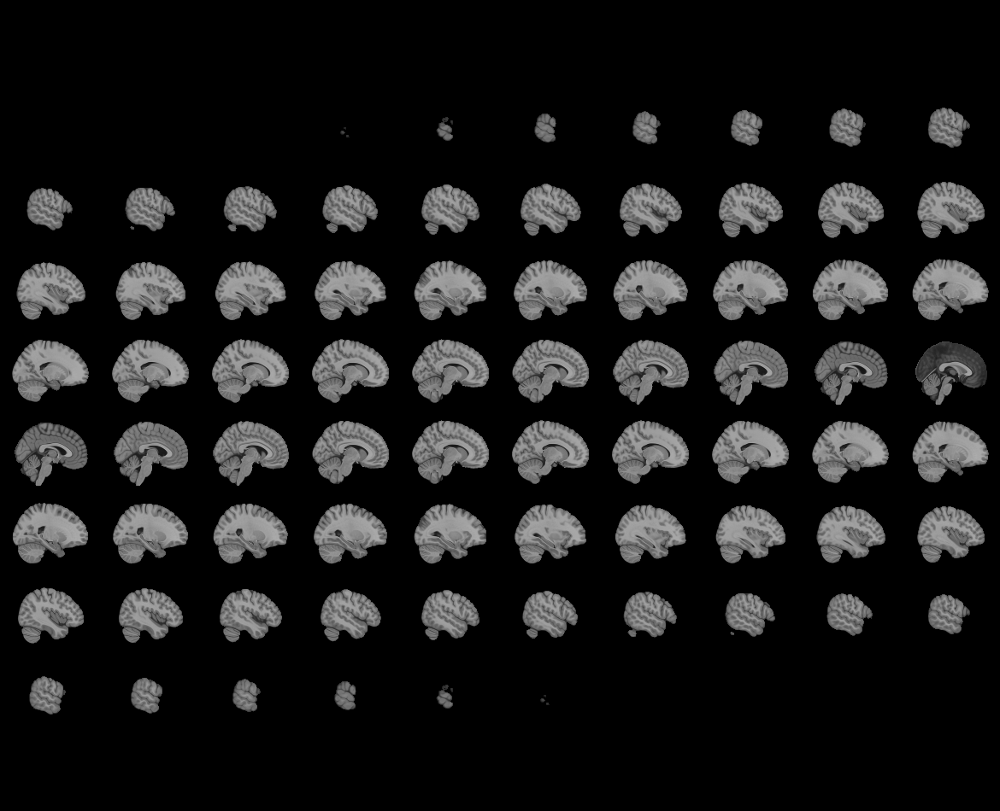
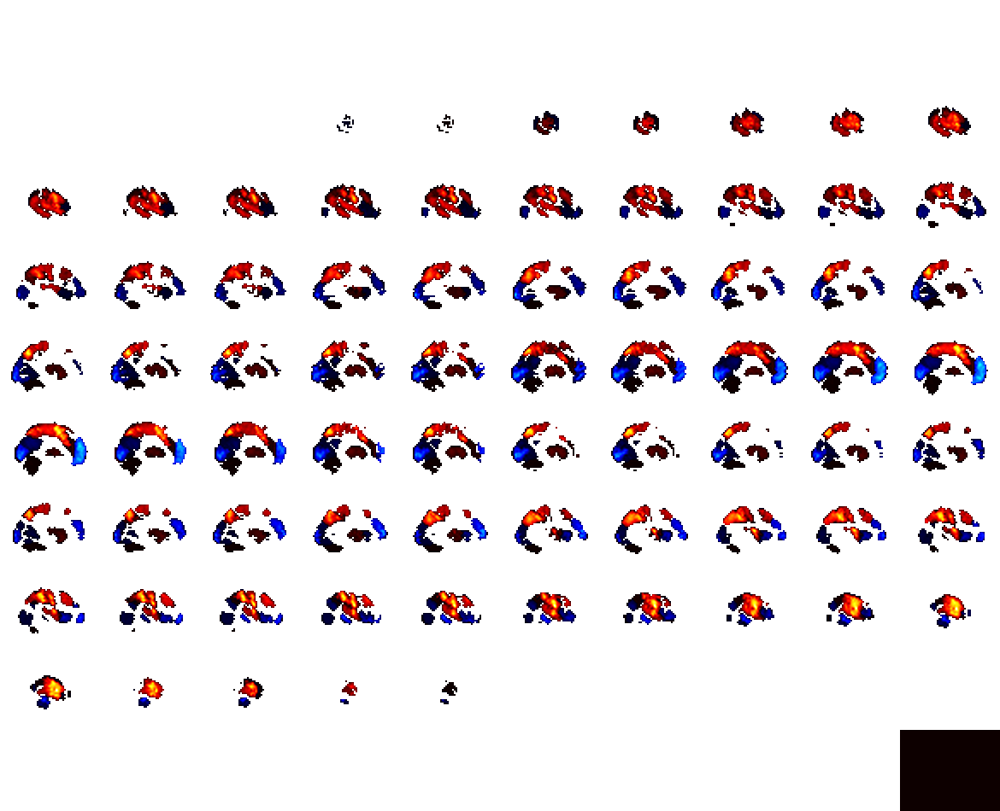

In [104]:
img = atlas_masker.inverse_transform(data_in_atlas2)

view_img(img.slicer[...,5])

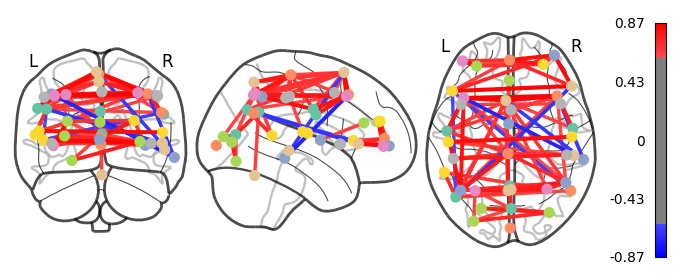

In [105]:
from nilearn.plotting import plot_connectome

coords = atlas_dataset.region_coords
# np.asarray(coords).shape
# We threshold to keep only the 10% of edges with the highest value
# because the graph is very dense
plot_connectome(correlation_matrix1, coords,
                edge_threshold="90%", colorbar=True)

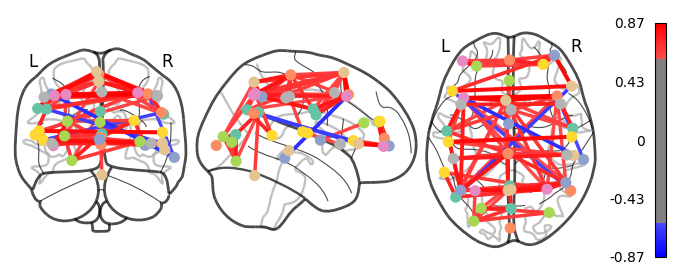

In [108]:
from nilearn.plotting import plot_connectome

coords = atlas_dataset.region_coords
# np.asarray(coords).shape
# We threshold to keep only the 10% of edges with the highest value
# because the graph is very dense
plot_connectome(correlation_matrix, coords,
                edge_threshold="90%", colorbar=True)

In [120]:
plotting.view_connectome(correlation_matrix1, coords, edge_threshold="85%")
    

In [113]:
plotting.view_connectome(correlation_matrix, coords,edge_threshold="80%")